<a href="https://colab.research.google.com/github/Mohameddfxxcxx/-Boston-Housing-Regression3/blob/main/Initial_Wound_Project.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [2]:

# IMPORTANT: RUN THIS CELL IN ORDER TO IMPORT YOUR KAGGLE DATA SOURCES
# TO THE CORRECT LOCATION (/kaggle/input) IN YOUR NOTEBOOK,
# THEN FEEL FREE TO DELETE THIS CELL.
# NOTE: THIS NOTEBOOK ENVIRONMENT DIFFERS FROM KAGGLE'S PYTHON
# ENVIRONMENT SO THERE MAY BE MISSING LIBRARIES USED BY YOUR
# NOTEBOOK.

import os
import sys
from tempfile import NamedTemporaryFile
from urllib.request import urlopen
from urllib.parse import unquote, urlparse
from urllib.error import HTTPError
from zipfile import ZipFile
import tarfile
import shutil

CHUNK_SIZE = 40960
DATA_SOURCE_MAPPING = 'wound-segmentation-images:https%3A%2F%2Fstorage.googleapis.com%2Fkaggle-data-sets%2F4456670%2F7645725%2Fbundle%2Farchive.zip%3FX-Goog-Algorithm%3DGOOG4-RSA-SHA256%26X-Goog-Credential%3Dgcp-kaggle-com%2540kaggle-161607.iam.gserviceaccount.com%252F20240820%252Fauto%252Fstorage%252Fgoog4_request%26X-Goog-Date%3D20240820T112042Z%26X-Goog-Expires%3D259200%26X-Goog-SignedHeaders%3Dhost%26X-Goog-Signature%3D7d097e8bbdcb4bd69a67d6a19fe20a39ac9ded64e640f460de89789bbefe81cb5e1fb1b58111d5c52f957678a12d4c50e7fd0f24dec7aaae5b0e216f6a00714a3dc65bb6b5f25628ead8bb6091b3143a4fed390aafe9f03ef47110dc56ff2ddaf760298318887cfa5b76b5851d5e3053cb33cef78b762c080ed1cd182c7d460f039ad6270c2fd9326a0e490e4f1cbca90da8ec90c7ed60a9b597904a8205e05a72aba558e0913845ced260ba8fc6cf09b2cfbd0c82642d5b1c8f4b3a385db92dcd9073e87dccbf59481f4206f5ceb5dd4d2679b61ec0fe02d5e155ba72afe221555b38931b9e646056d5eb5a2ea7f8297c8624a655990c50a33d319cd1ae1067'

KAGGLE_INPUT_PATH='/kaggle/input'
KAGGLE_WORKING_PATH='/kaggle/working'
KAGGLE_SYMLINK='kaggle'

!umount /kaggle/input/ 2> /dev/null
shutil.rmtree('/kaggle/input', ignore_errors=True)
os.makedirs(KAGGLE_INPUT_PATH, 0o777, exist_ok=True)
os.makedirs(KAGGLE_WORKING_PATH, 0o777, exist_ok=True)

try:
  os.symlink(KAGGLE_INPUT_PATH, os.path.join("..", 'input'), target_is_directory=True)
except FileExistsError:
  pass
try:
  os.symlink(KAGGLE_WORKING_PATH, os.path.join("..", 'working'), target_is_directory=True)
except FileExistsError:
  pass

for data_source_mapping in DATA_SOURCE_MAPPING.split(','):
    directory, download_url_encoded = data_source_mapping.split(':')
    download_url = unquote(download_url_encoded)
    filename = urlparse(download_url).path
    destination_path = os.path.join(KAGGLE_INPUT_PATH, directory)
    try:
        with urlopen(download_url) as fileres, NamedTemporaryFile() as tfile:
            total_length = fileres.headers['content-length']
            print(f'Downloading {directory}, {total_length} bytes compressed')
            dl = 0
            data = fileres.read(CHUNK_SIZE)
            while len(data) > 0:
                dl += len(data)
                tfile.write(data)
                done = int(50 * dl / int(total_length))
                sys.stdout.write(f"\r[{'=' * done}{' ' * (50-done)}] {dl} bytes downloaded")
                sys.stdout.flush()
                data = fileres.read(CHUNK_SIZE)
            if filename.endswith('.zip'):
              with ZipFile(tfile) as zfile:
                zfile.extractall(destination_path)
            else:
              with tarfile.open(tfile.name) as tarfile:
                tarfile.extractall(destination_path)
            print(f'\nDownloaded and uncompressed: {directory}')
    except HTTPError as e:
        print(f'Failed to load (likely expired) {download_url} to path {destination_path}')
        continue
    except OSError as e:
        print(f'Failed to load {download_url} to path {destination_path}')
        continue

print('Data source import complete.')


[==================================================] 697143967 bytes downloaded
Downloaded and uncompressed: wound-segmentation-images
Data source import complete.


In [3]:
import csv  # Module to work with CSV files
import pandas as pd  # Pandas library for data manipulation and analysis

In [4]:
# Install the colorlover library, which is used for generating color scales
!pip install colorlover

In [5]:
import colorlover as cl  # Importing colorlover for color scales and color manipulation

In [6]:
prefix = '/kaggle/input/wound-segmentation-images/data_wound_seg'  # Setting the path prefix to the wound segmentation images dataset directory

In [7]:
train_image_path = prefix + '/train_images'  # Path to the directory containing training images
train_mask_path = prefix + '/train_masks'  # Path to the directory containing training masks
test_image_path = prefix + '/test_images'  # Path to the directory containing testing images
test_mask_path = prefix + '/test_masks'  # Path to the directory containing testing masks

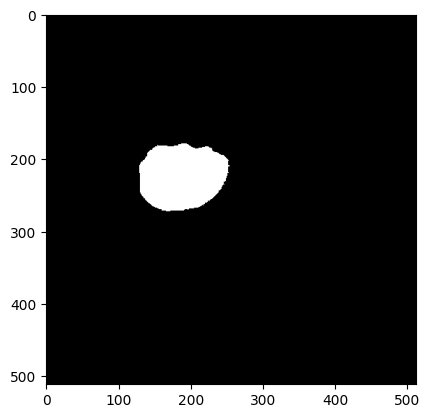

In [8]:
import time  # Importing time for handling time-related tasks (currently not used)
import numpy as np  # Importing NumPy for numerical operations on arrays
import pandas as pd  # Importing pandas for data manipulation and analysis
# from scipy import ndimage  # Commented out: could be used for image processing tasks

from matplotlib import pyplot as plt  # Importing pyplot for plotting and visualization
from matplotlib.pyplot import imread  # Importing imread for reading images

def read_mask_image(img_code):
    """
    Reads a mask image, converts it to a binary mask (0 or 1), and returns it.

    Parameters:
    img_code (str): Path to the mask image file

    Returns:
    numpy.ndarray: Binary mask image
    """
    mask_img_path = img_code
    mask_img = imread(mask_img_path)
    mask_img[mask_img <= 0] = 0  # Set all non-positive values to 0
    mask_img[mask_img > 0] = 1  # Set all positive values to 1
    return mask_img

def show_mask_image(img_code):
    """
    Displays a mask image using matplotlib.

    Parameters:
    img_code (str): Path to the mask image file
    """
    mask_img = read_mask_image(img_code)
    plt.imshow(mask_img, cmap='Greys_r')  # Display the mask image in grayscale
    plt.show()

# Example usage: Display a specific mask image from the dataset
show_mask_image('/kaggle/input/wound-segmentation-images/data_wound_seg/train_masks/fusc_0029.png')

In [9]:
def rle_encode(img):
    '''
    Encodes a binary mask image into run-length encoding (RLE) format.

    Parameters:
    img (numpy.ndarray): Binary mask image where 1 represents the mask and 0 represents the background

    Returns:
    str: Run-length encoded string
    '''
    pixels = img.flatten()  # Flatten the image into a 1D array
    pixels = np.concatenate([[0], pixels, [0]])  # Add padding to handle edge cases
    runs = np.where(pixels[1:] != pixels[:-1])[0] + 1  # Find start and end points of the mask
    runs[1::2] -= runs[::2]  # Calculate the lengths of the runs
    return ' '.join(str(x) for x in runs)  # Convert to a space-separated string

def rle_decode(mask_rle, shape):
    '''
    Decodes a run-length encoded string into a binary mask image.

    Parameters:
    mask_rle (str): Run-length encoded string (format: start length)
    shape (tuple): Shape of the output image (height, width)

    Returns:
    numpy.ndarray: Decoded binary mask image where 1 represents the mask and 0 represents the background
    '''
    s = mask_rle.split()  # Split the RLE string into start and length pairs
    starts, lengths = [np.asarray(x, dtype=int) for x in (s[0:][::2], s[1:][::2])]  # Convert to numpy arrays
    starts -= 1  # Convert to zero-based indexing
    ends = starts + lengths  # Calculate the end points of the runs
    img = np.zeros(shape[0] * shape[1], dtype=np.uint8)  # Initialize a flat array for the mask
    for lo, hi in zip(starts, ends):  # Set the mask pixels within each run
        img[lo:hi] = 1
    return img.reshape(shape)  # Reshape the flat array back to the original image shape

In [10]:
import numpy as np  # Importing NumPy for numerical operations on arrays
import imageio.v2  # Importing imageio for reading and writing images
import os  # Importing os for handling file and directory operations

def load_images(image_path, mask_path, get_masks=False):
    """
    Loads images and optionally their corresponding masks from the specified directories.

    Parameters:
    image_path (str): Path to the directory containing images.
    mask_path (str): Path to the directory containing masks.
    get_masks (bool): If True, masks will also be loaded.

    Returns:
    tuple:
    - images (numpy.ndarray): Array of loaded images.
    - masks (numpy.ndarray): Array of corresponding binary masks (only if get_masks is True).
    - image_sizes (numpy.ndarray): Array of image sizes (height, width) for each image.
    """
    images = []
    masks = []
    image_sizes = []
    files = os.listdir(image_path)  # List all files in the image directory
    for id in files:
        item_dir = image_path
        img = os.path.join(item_dir, id)  # Construct the full path to the image file
        image = imageio.v2.imread(img)  # Read the image
        image = image[:, :, :3]  # Remove the alpha channel if present, keeping only RGB channels
        images.append(image)
        image_sizes.append(image.shape[:2])  # Store the size (height, width) of the image

        if get_masks:
            masks_dir = mask_path
            m_path = os.path.join(masks_dir, id)  # Construct the full path to the mask file
            mask = imageio.v2.imread(m_path)  # Load the mask

            # Convert RGB masks to grayscale if they have 3 channels
            if len(mask.shape) == 3 and mask.shape[2] == 3:
                # Convert to grayscale by averaging the RGB channels
                mask = np.mean(mask, axis=2).astype(mask.dtype)

            mask = (mask > 0).astype(np.uint8)  # Convert to binary mask (0 and 1)
            masks.append(mask)

    if get_masks:
        return np.array(images), np.array(masks), np.array(image_sizes)  # Return images, masks, and image sizes
    else:
        return np.array(images), np.array(image_sizes)  # Return images and image sizes only

# Define the directory containing training images
TRAIN_DIR = train_image_path

# Load the training images and their corresponding masks
TRAIN_IMAGES, TRAIN_MASKS, TRAIN_IMAGE_SIZES = load_images(train_image_path, train_mask_path, True)

In [11]:
TRAIN_MASKS.shape  # Get the shape of the array containing training masks

(2208, 512, 512)

In [12]:
def getIfromRGB(rgb):
    """
    Converts an RGB color tuple to a single integer value.

    Parameters:
    rgb (tuple): A tuple representing an RGB color, e.g., (red, green, blue).

    Returns:
    int: The integer representation of the RGB color.
    """
    red = int(rgb[0])    # Extract the red component and convert it to an integer
    green = int(rgb[1])  # Extract the green component and convert it to an integer
    blue = int(rgb[2])   # Extract the blue component and convert it to an integer

    # Convert the RGB components to a single integer value
    RGBint = (red << 16) + (green << 8) + blue

    return RGBint  # Return the integer representation of the RGB color

In [13]:
""" Use a consistent color palette per label throughout the notebook """
import colorlover as cl  # Importing colorlover for color scales and color manipulation

# Reference for color scales: https://plot.ly/ipython-notebooks/color-scales/
# Select a color palette from colorlover scales
# Available palettes: 'Set3', 'Paired', etc.
# colors = cl.scales['4']['qual']['Set3']  # Example: Uncomment this line to use the 'Set3' palette
colors = cl.scales['4']['qual']['Paired']  # Use the 'Paired' palette for 4 qualitative colors

labels = np.array(range(1, 5))  # Define labels for the color palette (1 to 4)

# Combine labels with corresponding colors into a dictionary
palette = dict(zip(labels, np.array(cl.to_numeric(colors))))

# Display the color palette dictionary
palette

{1: array([166., 206., 227.]),
 2: array([ 31., 120., 180.]),
 3: array([178., 223., 138.]),
 4: array([ 51., 160.,  44.])}

In [14]:
!git clone https://github.com/facebookresearch/detectron2.git  # Clone the Detectron2 repository from GitHub

Cloning into 'detectron2'...
remote: Enumerating objects: 15756, done.
remote: Counting objects: 100% (13/13), done.
remote: Compressing objects: 100% (12/12), done.
remote: Total 15756 (delta 1), reused 11 (delta 1), pack-reused 15743 (from 1)
Receiving objects: 100% (15756/15756), 6.32 MiB | 17.79 MiB/s, done.
Resolving deltas: 100% (11497/11497), done.


In [15]:
# Check the current working directory
import os
print(os.getcwd())

# List the directories in the current path to ensure 'detectron2' exists
print(os.listdir())

# If 'detectron2' is present, change to that directory
%cd detectron2

/content
['.config', 'detectron2', 'sample_data']
/content/detectron2


In [16]:
!pip install -U .  # Install or upgrade the package in the current directory

Processing /content/detectron2
  Preparing metadata (setup.py) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 50.2/50.2 kB 882.5 kB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 78.2/78.2 kB 2.6 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 117.0/117.0 kB 4.6 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
  Using cached pathspec-0.12.1-py3-none-any.whl.metadata (21 kB)
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 154.5/154.5 kB 7.1 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 79.5/79.5 kB 4.4 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 427.8/427.8 kB 7.2 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.8/1.8 MB 22.7 MB/s eta 0:00:00
Using cached pathspec-0.12.1-py3-none-any.whl (31 kB)
  Created wheel for detectron2: filename=detectron2-0.6-cp310-cp310-linux_x86_64.whl size=5792475 sha256=5c2a13fc9b31694dc39d6b0b8d257fe0eba75f8e3b75fe8ef913be87094762c

In [17]:
!pip wheel .  # Create a wheel distribution of the package in the current directory

Processing /content/detectron2
  Preparing metadata (setup.py) ... done
  Using cached pillow-10.4.0-cp310-cp310-manylinux_2_28_x86_64.whl.metadata (9.2 kB)
  Using cached pycocotools-2.0.8-cp310-cp310-manylinux_2_17_x86_64.manylinux2014_x86_64.whl.metadata (1.1 kB)
  Using cached termcolor-2.4.0-py3-none-any.whl.metadata (6.1 kB)
  Using cached yacs-0.1.8-py3-none-any.whl.metadata (639 bytes)
  Using cached tabulate-0.9.0-py3-none-any.whl.metadata (34 kB)
  Using cached cloudpickle-3.0.0-py3-none-any.whl.metadata (7.0 kB)
  Using cached tqdm-4.66.5-py3-none-any.whl.metadata (57 kB)
  Using cached fvcore-0.1.5.post20221221-py3-none-any.whl
  Using cached iopath-0.1.9-py3-none-any.whl.metadata (370 bytes)
  Using cached omegaconf-2.3.0-py3-none-any.whl.metadata (3.9 kB)
  Using cached hydra_core-1.3.2-py3-none-any.whl.metadata (5.5 kB)
  Using cached black-24.8.0-cp310-cp310-manylinux_2_17_x86_64.manylinux2014_x86_64.manylinux_2_28_x86_64.whl.metadata (78 kB)
  Using cached packaging-24

In [18]:
import detectron2  # Import the Detectron2 library for object detection and segmentation
from detectron2.utils.logger import setup_logger  # Import the function to set up logging for Detectron2
setup_logger()  # Set up logging for Detectron2 to track progress and errors

# Import common libraries
import numpy as np  # Import NumPy for numerical operations on arrays
import os  # Import os for operating system interfaces
import json  # Import json for handling JSON data
import cv2  # Import OpenCV for computer vision tasks
import random  # Import random for generating random numbers
import matplotlib.pyplot as plt  # Import matplotlib for plotting and visualization

# Ensure that plots are displayed inline within the notebook
%matplotlib inline

# Import Detectron2 utilities
from detectron2 import model_zoo  # Import the model_zoo for loading pre-trained models
from detectron2.engine import DefaultPredictor  # Import DefaultPredictor for making predictions
from detectron2.config import get_cfg  # Import get_cfg to manage configuration files
from detectron2.utils.visualizer import Visualizer  # Import Visualizer for visualizing predictions
from detectron2.data import MetadataCatalog, DatasetCatalog  # Import MetadataCatalog and DatasetCatalog for managing datasets
from detectron2.structures import BoxMode  # Import BoxMode for handling bounding boxes

In [19]:
import torch

# Check if CUDA is available and set the device accordingly
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')

# Create a configuration object for Detectron2
cfg = get_cfg()

# Add project-specific configuration here if you're not using a model from Detectron2's core library
cfg.merge_from_file(model_zoo.get_config_file("COCO-InstanceSegmentation/mask_rcnn_R_50_FPN_3x.yaml"))

# Set the threshold for object detection predictions
cfg.MODEL.ROI_HEADS.SCORE_THRESH_TEST = 0.5

# Specify the model weights to use for the predictions
cfg.MODEL.WEIGHTS = model_zoo.get_checkpoint_url("COCO-InstanceSegmentation/mask_rcnn_R_50_FPN_3x.yaml")

# Ensure the model is configured to run on CPU
cfg.MODEL.DEVICE = str(device)

# Create a predictor instance using the configuration
predictor = DefaultPredictor(cfg)

[08/20 17:41:47 d2.checkpoint.detection_checkpoint]: [DetectionCheckpointer] Loading from https://dl.fbaipublicfiles.com/detectron2/COCO-InstanceSegmentation/mask_rcnn_R_50_FPN_3x/137849600/model_final_f10217.pkl ...


model_final_f10217.pkl: 178MB [00:00, 209MB/s]                           


In [20]:
import torch

# Create a tensor on the CPU
some_tensor = torch.randn(1000, 1000)

# Perform operations with the tensor
# ...

# Delete the tensor
del some_tensor

# Since we are not using CUDA, clearing the cache is not necessary

In [21]:
import cv2

def binary_mask_to_polygon(mask):
    """
    Convert a binary mask to a list of polygons representing the mask contours.

    Parameters:
    - mask: numpy array, binary mask where non-zero values represent the object.

    Returns:
    - segmentation: list of lists, each containing the flattened coordinates of a polygon.
    """
    # Find contours in the binary mask
    contours, _ = cv2.findContours(mask, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)

    segmentation = []

    # Iterate over each contour found
    for contour in contours:
        # Flatten the contour array and convert to list
        contour = contour.flatten().tolist()

        # Append the contour to segmentation if it has more than 4 points
        if len(contour) > 4:
            segmentation.append(contour)

    return segmentation

In [22]:
import cv2
import numpy as np
import os
from detectron2.structures import BoxMode
from copy import deepcopy as dc

def binary_mask_to_polygon(mask):
    """
    Convert a binary mask to a list of polygons representing the mask contours.

    Parameters:
    - mask: numpy array, binary mask where non-zero values represent the object.

    Returns:
    - segmentation: list of lists, each containing the flattened coordinates of a polygon.
    """
    contours, _ = cv2.findContours(mask, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
    segmentation = []
    for contour in contours:
        contour = contour.flatten().tolist()
        if len(contour) > 4:
            segmentation.append(contour)
    return segmentation

def get_data_dicts(image_path, masks_data):
    """
    Prepare data dictionaries for Detectron2 from images and their corresponding masks.

    Parameters:
    - image_path: str, path to the directory containing the images.
    - masks_data: list of numpy arrays, each representing a binary mask for the images.

    Returns:
    - dataset_dicts: list of dictionaries, each containing metadata and annotations for an image.
    """
    dataset_dicts = []

    imgs = os.listdir(image_path)  # List all files in the image directory

    for idx, img_file_name, mask in zip(range(len(imgs)), imgs, masks_data):
        record = {}
        file_path = os.path.join(image_path, img_file_name)
        record["file_name"] = file_path
        record["image_id"] = idx + 1  # Unique ID for each image

        # Read and process the image
        img = cv2.imread(file_path)
        img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
        record["height"], record["width"] = img.shape[:2]

        # Convert the mask to polygons
        polygons = binary_mask_to_polygon(mask)

        annotations = []
        for polygon in polygons:
            # Create annotation dictionary
            annotation = {
                'bbox': [min(polygon[::2]), min(polygon[1::2]), max(polygon[::2]), max(polygon[1::2])],
                'bbox_mode': BoxMode.XYXY_ABS,
                'segmentation': [polygon],
                "category_id": 0,
            }
            annotations.append(annotation)

        record["annotations"] = annotations
        dataset_dicts.append(record)

    return dataset_dicts

# Prepare the dataset dictionaries
dataset_dicts = get_data_dicts(train_image_path, TRAIN_MASKS)

def dataset_split(d):
    """
    Split the dataset into training and validation sets.

    Parameters:
    - d: str, either 'data_train' or 'data_val'.

    Returns:
    - A list of dictionaries corresponding to the specified split.
    """
    split = {
        "data_train": dataset_dicts[:int(len(dataset_dicts) * 0.8)],
        "data_val": dataset_dicts[int(len(dataset_dicts) * 0.8):]
    }
    return split[d]

# Register datasets with Detectron2
for d in ["data_train", "data_val"]:
    DatasetCatalog.register(d, lambda d=d: dataset_split(d))
    MetadataCatalog.get(d).set(thing_classes=["Wound"])

# Access metadata for the training dataset
wound_metadata = MetadataCatalog.get("data_train")

In [23]:
import torch
from detectron2.engine import DefaultTrainer
from detectron2.config import get_cfg
from detectron2 import model_zoo
import os

# Function to force CPU mode
def force_cpu_mode(cfg):
    cfg.MODEL.DEVICE = "cpu"  # Force model to run on CPU

# Set up the configuration for training
cfg = get_cfg()
cfg.merge_from_file(model_zoo.get_config_file("COCO-InstanceSegmentation/mask_rcnn_R_50_FPN_3x.yaml"))

# Specify the dataset to be used for training and testing
cfg.DATASETS.TRAIN = ("data_train",)  # Use the 'data_train' dataset for training
cfg.DATASETS.TEST = ()  # No testing dataset specified

# Set data loader parameters
cfg.DATALOADER.NUM_WORKERS = 2  # Number of data loading workers

# Specify model weights for initialization from the model zoo
cfg.MODEL.WEIGHTS = model_zoo.get_checkpoint_url("COCO-InstanceSegmentation/mask_rcnn_R_50_FPN_3x.yaml")

# Set solver parameters
cfg.SOLVER.IMS_PER_BATCH = 2  # Use a smaller batch size for CPU
cfg.SOLVER.BASE_LR = 0.00025  # Base learning rate
cfg.SOLVER.MAX_ITER = 1000    # Maximum number of iterations for training
cfg.SOLVER.STEPS = []        # No learning rate decay

# Set ROI Heads parameters
cfg.MODEL.ROI_HEADS.BATCH_SIZE_PER_IMAGE = 32   # Number of proposals to be used per image
cfg.MODEL.ROI_HEADS.NUM_CLASSES = 1  # Number of classes in the dataset (1 class for wounds)

# Create output directory if it does not exist
os.makedirs(cfg.OUTPUT_DIR, exist_ok=True)

# Force CPU mode
force_cpu_mode(cfg)

# Initialize and start training
trainer = DefaultTrainer(cfg)
trainer.resume_or_load(resume=False)  # Load the model checkpoint or start fresh

# Begin training
trainer.train()

[08/20 17:42:05 d2.engine.defaults]: Model:
GeneralizedRCNN(
  (backbone): FPN(
    (fpn_lateral2): Conv2d(256, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output2): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral3): Conv2d(512, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output3): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral4): Conv2d(1024, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output4): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral5): Conv2d(2048, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output5): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (top_block): LastLevelMaxPool()
    (bottom_up): ResNet(
      (stem): BasicStem(
        (conv1): Conv2d(
          3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False
          (norm): FrozenBatchNorm2d(num_features=64, eps=1e-05)
        )
      )
      (res

roi_heads.box_predictor.bbox_pred.{bias, weight}
roi_heads.box_predictor.cls_score.{bias, weight}
roi_heads.mask_head.predictor.{bias, weight}


[08/20 17:42:05 d2.engine.train_loop]: Starting training from iteration 0


/usr/local/lib/python3.10/dist-packages/torch/functional.py:512: UserWarning: torch.meshgrid: in an upcoming release, it will be required to pass the indexing argument. (Triggered internally at ../aten/src/ATen/native/TensorShape.cpp:3587.)
  return _VF.meshgrid(tensors, **kwargs)  # type: ignore[attr-defined]


[08/20 17:42:47 d2.utils.events]:  eta: 0:32:49  iter: 19  total_loss: 2.23  loss_cls: 0.7543  loss_box_reg: 0.782  loss_mask: 0.6902  loss_rpn_cls: 0.0857  loss_rpn_loc: 0.009968    time: 1.9637  last_time: 1.9851  data_time: 0.0152  last_data_time: 0.0061   lr: 4.9953e-06  
[08/20 17:43:30 d2.utils.events]:  eta: 0:32:17  iter: 39  total_loss: 2.252  loss_cls: 0.6939  loss_box_reg: 0.8388  loss_mask: 0.6826  loss_rpn_cls: 0.04197  loss_rpn_loc: 0.008045    time: 1.9791  last_time: 2.1334  data_time: 0.0056  last_data_time: 0.0061   lr: 9.9902e-06  
[08/20 17:44:09 d2.utils.events]:  eta: 0:31:14  iter: 59  total_loss: 1.996  loss_cls: 0.5976  loss_box_reg: 0.5363  loss_mask: 0.6717  loss_rpn_cls: 0.07045  loss_rpn_loc: 0.007336    time: 1.9621  last_time: 2.2367  data_time: 0.0055  last_data_time: 0.0054   lr: 1.4985e-05  
[08/20 17:44:48 d2.utils.events]:  eta: 0:30:34  iter: 79  total_loss: 1.817  loss_cls: 0.503  loss_box_reg: 0.5519  loss_mask: 0.6418  loss_rpn_cls: 0.04783  loss

In [24]:
from detectron2.engine import DefaultPredictor

# Set the path to the trained model weights
cfg.MODEL.WEIGHTS = os.path.join(cfg.OUTPUT_DIR, "model_final.pth")

# Set a custom threshold for the ROI Heads during testing
cfg.MODEL.ROI_HEADS.SCORE_THRESH_TEST = 0.5  # Threshold for object detection score

# Initialize the DefaultPredictor with the updated configuration
predictor = DefaultPredictor(cfg)

[08/20 18:17:23 d2.checkpoint.detection_checkpoint]: [DetectionCheckpointer] Loading from ./output/model_final.pth ...


In [25]:
# Retrieve the validation dataset from the dataset split function
train_dicts = dataset_split("data_val")

# Explanation:
# - dataset_split("data_val"): Calls the dataset_split function to get the validation data.
# - "data_val": The argument specifies that we want to access the validation portion of the dataset.
# - train_dicts: Variable holding the dictionary of validation data.

In [26]:
from detectron2.utils.visualizer import ColorMode

# Explanation:
# - This import statement brings in the ColorMode class from the visualizer module of detectron2.
# - ColorMode is used to control how colors are applied to visualizations, such as masks and bounding boxes, in detectron2.

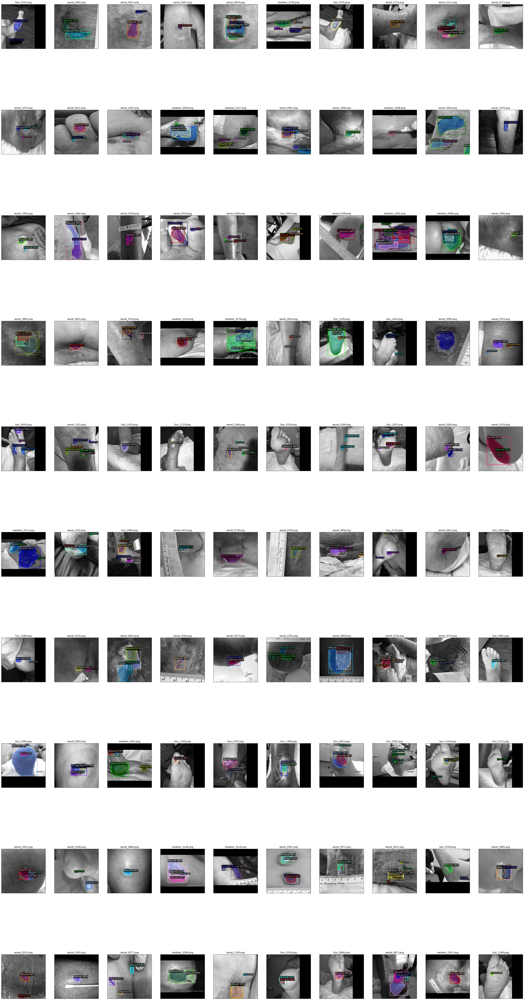

In [27]:
import cv2
import matplotlib.pyplot as plt
from detectron2.utils.visualizer import Visualizer, ColorMode

# Create a figure with specified size
fig = plt.figure(figsize=(50, 100))
columns = 10
rows = 10

# Loop through a subset of the training dataset (up to 100 images)
for i, d in enumerate(train_dicts):
    if i >= 100:
        break

    # Read the image from the file path
    im = cv2.imread(d["file_name"])

    # Perform inference on the image using the predictor
    outputs = predictor(im)

    # Create a Visualizer object for drawing predictions
    v = Visualizer(
        im[:, :, ::-1],  # Convert BGR to RGB for visualization
        metadata=wound_metadata,
        scale=0.5,
        instance_mode=ColorMode.IMAGE_BW  # Use black and white for unsegmented pixels
    )

    # Draw the instance predictions on the image
    out = v.draw_instance_predictions(outputs["instances"].to("cpu"))

    # Add a subplot to the figure for the current image
    ax = fig.add_subplot(rows, columns, i + 1)

    # Set the title of the subplot to the image file name
    ax.set_title(f'{d["file_name"].split("/")[-1]}')

    # Hide tick marks and labels on the axes
    ax.tick_params(
        axis='both', which='both', bottom=False, top=False, left=False, right=False,
        labelbottom=False, labelleft=False
    )

    # Display the image with predictions
    ax.imshow(out.get_image()[:, :, ::-1])  # Convert RGB to BGR for displaying

# Show the entire grid of images with predictions
plt.show()

In [28]:
from detectron2.data import build_detection_test_loader
from detectron2.evaluation import COCOEvaluator, inference_on_dataset

# Create an evaluator for the dataset using the COCO evaluation metrics
evaluator = COCOEvaluator("data_train", cfg, False, output_dir="./output/")

# Build the data loader for the validation dataset
val_loader = build_detection_test_loader(cfg, "data_train")

# Perform inference on the validation dataset and evaluate the results using the evaluator
results = inference_on_dataset(trainer.model, val_loader, evaluator)

# Print the evaluation results
print(results)

[08/20 18:22:56 d2.evaluation.coco_evaluation]: Fast COCO eval is not built. Falling back to official COCO eval.
WARNING [08/20 18:22:56 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass in explicit arguments instead.
[08/20 18:22:56 d2.evaluation.coco_evaluation]: Trying to convert 'data_train' to COCO format ...
[08/20 18:22:56 d2.data.datasets.coco]: Converting annotations of dataset 'data_train' to COCO format ...)
[08/20 18:22:56 d2.data.datasets.coco]: Converting dataset dicts into COCO format
[08/20 18:22:56 d2.data.datasets.coco]: Conversion finished, #images: 1766, #annotations: 2168
[08/20 18:22:56 d2.data.datasets.coco]: Caching COCO format annotations at './output/data_train_coco_format.json' ...
[08/20 18:22:57 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[08/20 18:22:57 d2.data.common]: Seria

/usr/lib/python3.10/multiprocessing/popen_fork.py:66: RuntimeWarning: os.fork() was called. os.fork() is incompatible with multithreaded code, and JAX is multithreaded, so this will likely lead to a deadlock.
  self.pid = os.fork()


[08/20 18:23:10 d2.evaluation.evaluator]: Inference done 11/1766. Dataloading: 0.0021 s/iter. Inference: 0.9414 s/iter. Eval: 0.0083 s/iter. Total: 0.9518 s/iter. ETA=0:27:50
[08/20 18:23:15 d2.evaluation.evaluator]: Inference done 18/1766. Dataloading: 0.0020 s/iter. Inference: 0.8396 s/iter. Eval: 0.0065 s/iter. Total: 0.8487 s/iter. ETA=0:24:43
[08/20 18:23:21 d2.evaluation.evaluator]: Inference done 25/1766. Dataloading: 0.0020 s/iter. Inference: 0.8331 s/iter. Eval: 0.0068 s/iter. Total: 0.8424 s/iter. ETA=0:24:26
[08/20 18:23:26 d2.evaluation.evaluator]: Inference done 32/1766. Dataloading: 0.0020 s/iter. Inference: 0.8216 s/iter. Eval: 0.0070 s/iter. Total: 0.8309 s/iter. ETA=0:24:00
[08/20 18:23:32 d2.evaluation.evaluator]: Inference done 39/1766. Dataloading: 0.0019 s/iter. Inference: 0.8173 s/iter. Eval: 0.0069 s/iter. Total: 0.8266 s/iter. ETA=0:23:47
[08/20 18:23:37 d2.evaluation.evaluator]: Inference done 46/1766. Dataloading: 0.0019 s/iter. Inference: 0.8062 s/iter. Eval:

In [29]:
# Load test images and their corresponding masks
TEST_IMAGES, TEST_MASKS, TEST_IMAGE_SIZES = load_images(test_image_path, test_mask_path, True)

In [30]:
# Generate dataset dictionaries for the test images and masks
dataset_dicts = get_data_dicts(test_image_path, TEST_MASKS)

# Register the test dataset in the DatasetCatalog
DatasetCatalog.register("test_data", lambda: dataset_dicts)

# Set metadata for the test dataset
MetadataCatalog.get("test_data").set(thing_classes=["Wound"])

# Retrieve metadata for the test dataset
wound_metadata = MetadataCatalog.get("test_data")

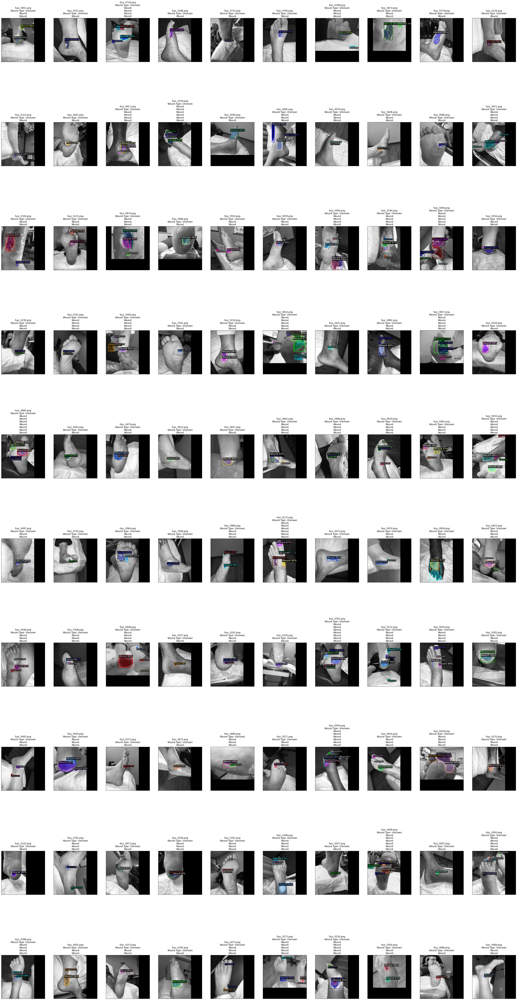

In [39]:
import cv2
import matplotlib.pyplot as plt
from detectron2.utils.visualizer import Visualizer, ColorMode

# Create a figure for displaying images
fig = plt.figure(figsize=(50, 100))
columns = 10  # Number of columns in the grid
rows = 10     # Number of rows in the grid

# Get the class names from metadata
class_names = wound_metadata.thing_classes

# Loop through the dataset dictionaries to visualize predictions
for i, d in enumerate(dataset_dicts):
    if i >= 100:  # Limit the number of images to display
        break
    # Read the image
    im = cv2.imread(d["file_name"])

    # Perform inference on the image
    outputs = predictor(im)

    # Create a Visualizer object for the image
    v = Visualizer(im[:, :, ::-1],  # Convert BGR to RGB
                   metadata=wound_metadata,
                   scale=0.5,  # Scale the image
                   instance_mode=ColorMode.IMAGE_BW   # Remove colors of unsegmented pixels
    )

    # Draw instance predictions on the image
    out = v.draw_instance_predictions(outputs["instances"].to("cpu"))

    # Add subplot for each image
    ax = fig.add_subplot(rows, columns, i + 1)

    # Get predictions and their classes
    instances = outputs["instances"].to("cpu")
    classes = instances.pred_classes.numpy()

    # Construct title with class names and wound type
    title_text = f'{d["file_name"].split("/")[-1]}'
    wound_type = d.get("wound_type", "Unknown")  # Get wound type or default to "Unknown"
    title_text += f'\nWound Type: {wound_type}'
    for cls in classes:
        title_text += f'\n{class_names[cls]}'

    # Set the title of the subplot
    ax.set_title(title_text)

    # Hide axes ticks and labels
    ax.tick_params(axis='both', which='both', bottom=False, top=False, left=False, right=False,
                   labelbottom=False, labelleft=False)

    # Display the image with predictions
    ax.imshow(out.get_image()[:, :, ::-1])  # Convert RGB back to BGR for display

# Show the figure with all subplots
plt.show()